In [ ]:
!pip install torch_geometric
from google.colab import drive
drive.mount('/content/gdrive', force_remount = True)

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 661.6/661.6 kB 12.2 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for torch_geometric: filename=torch_geometric-2.3.1-py3-none-any.whl size=910459 sha256=f3197246a7f710c6541cc552461799a8f0e3fc8d3a39dd00393892f374cbb4bb
  Stored in directory: /root/.cache/pip/wheels/ac/dc/30/e2874821ff308ee67dcd7a66dbde912411e19e35a1addda028
Successfully built torch_geometric
Mounted at /content/gdrive


### Code to draw the bounding boxes using K-Means Clustering

In [ ]:
import cv2
import os
import numpy as np
from sklearn.cluster import KMeans

# Step 1: Load the Images
img_path = "/content/gdrive/MyDrive/images-kaggle"

img_files = os.listdir(img_path)
gray_imgs = []
for img_file in img_files:
    img = cv2.imread(os.path.join(img_path, img_file))
    gray_img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
    gray_imgs.append(gray_img)

# Step 2: Thresholding
threshold_value = 200
segmented_imgs = []
for gray_img in gray_imgs:
    _, segmented_img = cv2.threshold(gray_img, threshold_value, 255, cv2.THRESH_BINARY)
    segmented_imgs.append(segmented_img)

# Step 3: Apply K-Means Clustering
kmeans_imgs = []
for segmented_img in segmented_imgs:
    pixel_values = segmented_img.reshape((-1, 1))
    kmeans = KMeans(n_clusters=2).fit(pixel_values)+
    segmented_img = kmeans.labels_.reshape(segmented_img.shape)
    kmeans_imgs.append(segmented_img)

# Step 4: Bounding Boxes
def detect_bounding_boxes(img, color):
    h, w = img.shape
    contours, _ = cv2.findContours(img, cv2.RETR_EXTERNAL, cv2.CHAIN_APPROX_SIMPLE)
    bounding_boxes = []
    for cnt in contours:
        x, y, box_w, box_h = cv2.boundingRect(cnt)
        if box_w < 10 or box_h < 10 or box_w > w/2 or box_h > h/2:
            continue
        bounding_boxes.append((x, y, box_w, box_h, color))
    return bounding_boxes

red_bboxes = []
blue_bboxes = []
for kmeans_img in kmeans_imgs:
    red_mask = (kmeans_img == 0).astype(np.uint8)
    blue_mask = (kmeans_img == 1).astype(np.uint8)
    red_bboxes.append(detect_bounding_boxes(red_mask, 'red'))
    blue_bboxes.append(detect_bounding_boxes(blue_mask, 'blue'))


/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning: The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning
  warnings.warn(
/usr/local/lib/python3.10/dist-packages/sklearn/cluster/_kmeans.py:8

The provided code snippet performs K-means clustering on a set of segmented images. Here's a breakdown of what each line does:

1. `kmeans_imgs = []`: Initializes an empty list called `kmeans_imgs`. This list will store the segmented images after applying K-means clustering.

2. `for segmented_img in segmented_imgs:`: Iterates over a list of segmented images, where `segmented_imgs` is assumed to be a collection of image arrays.

3. `pixel_values = segmented_img.reshape((-1, 1))`: Reshapes the current segmented image array into a 1-dimensional column vector. The `-1` argument is used to infer the size of one dimension based on the other dimensions, ensuring that the resulting array has one column and a suitable number of rows.

4. `kmeans = KMeans(n_clusters=2).fit(pixel_values)`: Performs K-means clustering on the reshaped pixel values. The `n_clusters` parameter is set to `2`, indicating that the algorithm should find two clusters in the data. The `fit()` method is called to train the K-means model on the pixel values.

5. `segmented_img = kmeans.labels_.reshape(segmented_img.shape)`: Retrieves the cluster labels assigned by K-means and reshapes them to match the original shape of the segmented image array. Each pixel in the segmented image will be assigned a label representing the cluster it belongs to.

6. `kmeans_imgs.append(segmented_img)`: Adds the segmented image with cluster labels to the `kmeans_imgs` list.

Overall, the code applies K-means clustering to each segmented image in the `segmented_imgs` list. It reshapes the pixel values, trains a K-means model with two clusters, assigns labels to each pixel, and stores the resulting segmented image with cluster labels in the `kmeans_imgs` list. This process is repeated for each segmented image in the loop, ultimately producing a list of segmented images with K-means clustering applied.

A contour is defined as simply a curve joining all continuous points(along the boundary), having same colour or intensity.


In [ ]:
# Step 5: Save the Labels
labels_path = '/content/drive/MyDrive/bounding_box'
if len(img_files) != len(red_bboxes) or len(img_files) != len(blue_bboxes):
    print("Error: Number of image files and bounding box lists do not match.")
    print(f"len(img_files) = {len(img_files)}")
    print(f"len(red_bboxes) = {len(red_bboxes)}")
    print(f"len(blue_bboxes) = {len(blue_bboxes)}")
else:
    for i, img_file in enumerate(img_files):
        red_boxes_file = os.path.join(labels_path, img_file[:-4] + '_red.npy')
        blue_boxes_file = os.path.join(labels_path, img_file[:-4] + '_blue.npy')
        np.save(red_boxes_file, np.array(red_bboxes[i]))
        np.save(blue_boxes_file, np.array(blue_bboxes[i]))
        print(f"Bounding boxes for {img_file} saved in {red_boxes_file} and {blue_boxes_file}")



# Step 6: Load the Labels
labels_path = '/content/drive/MyDrive/bounding_box'
red_bboxes = []
blue_bboxes = []
for img_file in img_files:
    red_boxes_file = os.path.join(labels_path, img_file[:-4] + '_red.npy')
    blue_boxes_file = os.path.join(labels_path, img_file[:-4] + '_blue.npy')
    red_bboxes.append(np.load(red_boxes_file))
    blue_bboxes.append(np.load(blue_boxes_file))

print("Bounding box labels loaded successfully!")


# Step 7: Draw the Bounding Boxes
output_path = '/content/drive/MyDrive/bounding_box_img'
if not os.path.exists(output_path):
    os.makedirs(output_path)

for i, img_file in enumerate(img_files):
    img = cv2.imread(os.path.join(img_path, img_file))
    for bbox in red_bboxes[i]:
        x, y, w, h = bbox
        img = cv2.rectangle(img, (x, y), (x + w, y + h), (0, 0, 255), 2)
    for bbox in blue_bboxes[i]:
        x, y, w, h = bbox
        img = cv2.rectangle(img, (x, y), (x + w, y + h), (255, 0, 0), 2)
    output_file = os.path.join(output_path, img_file)
    cv2.imwrite(output_file, img)
    print(f"Bounding boxes drawn on {img_file} and saved in {output_file}")



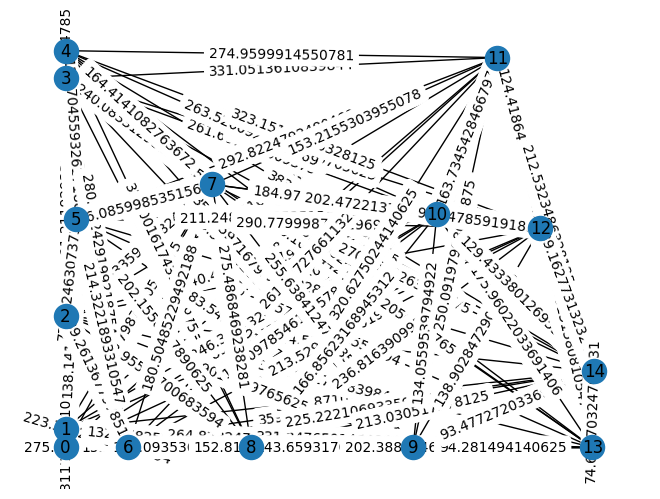

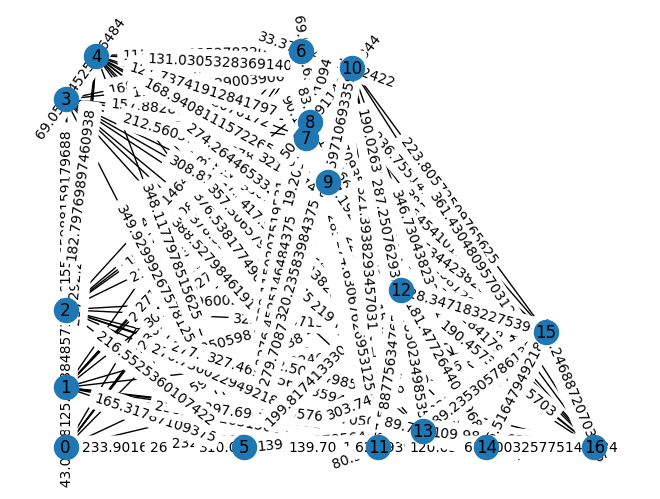

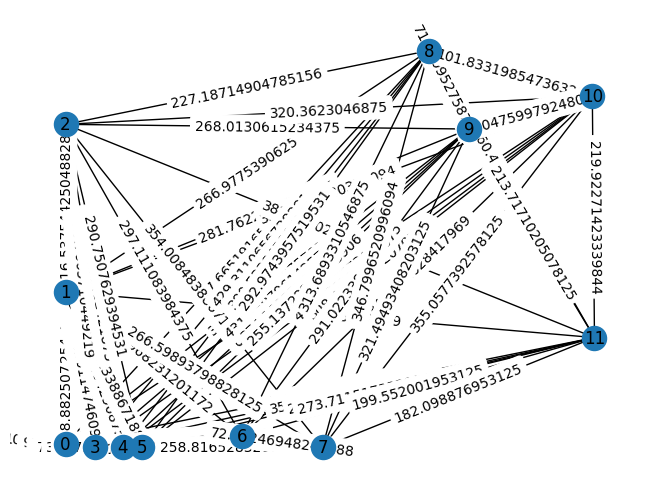

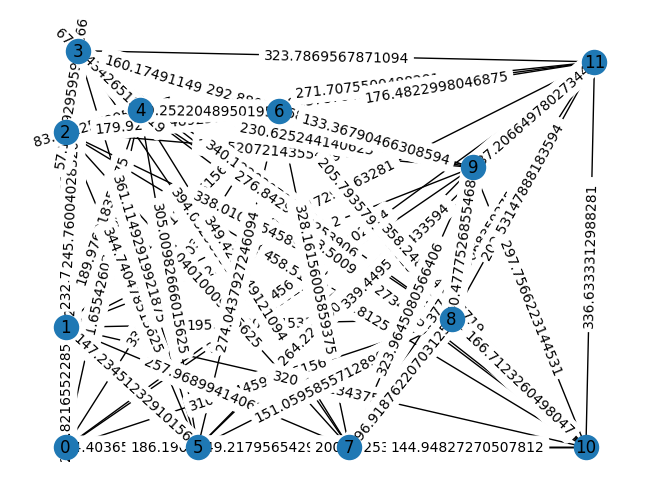

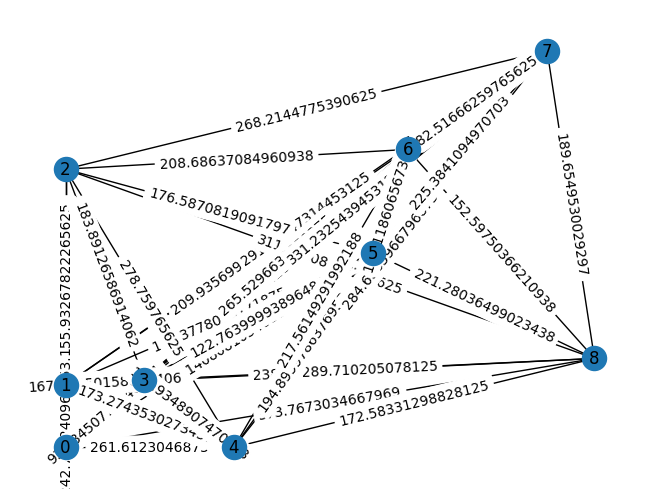

...

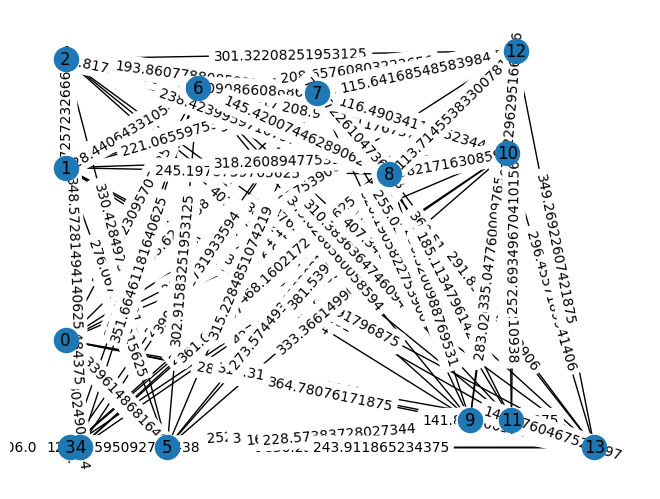

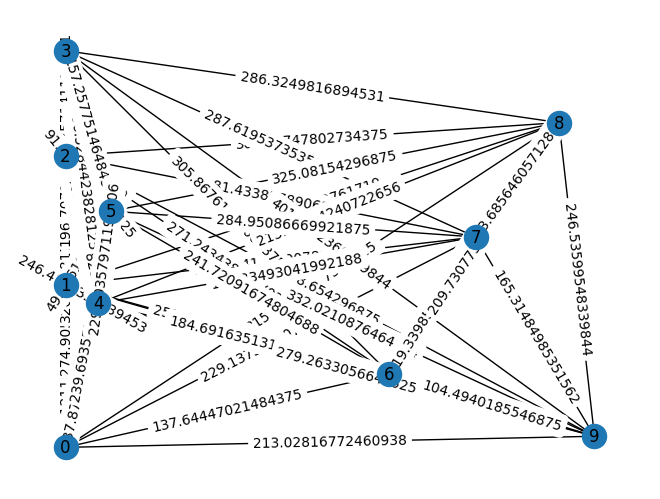

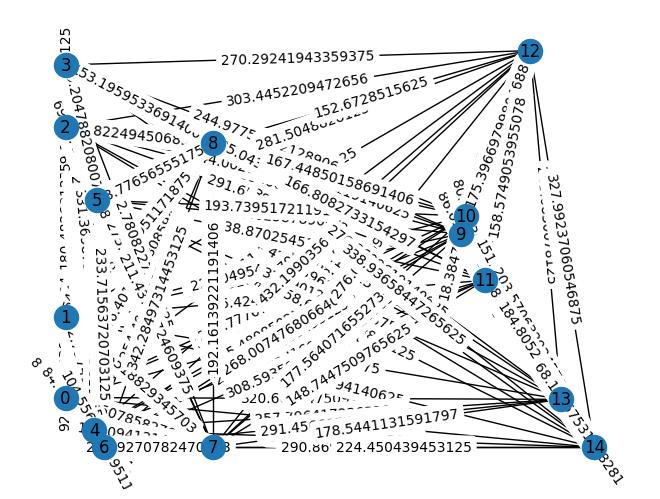

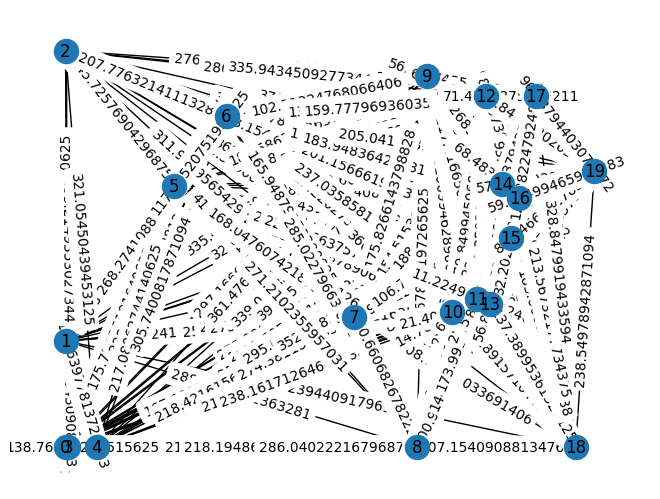

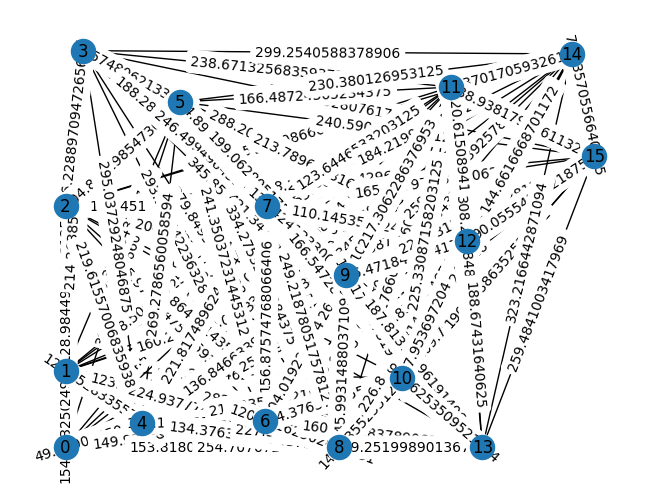

In [ ]:
import os
import numpy as np
import torch
import torch_geometric
from torch_geometric.data import Data
import networkx as nx
import matplotlib.pyplot as plt

# Define the path to the folder containing the .npy files with bounding box coordinates
bbox_dir = "/content/drive/MyDrive/boxcoord/"

# Define GNN parameters
in_channels = 4  # X, Y coordinates of the top-left and bottom-right corners of each bounding box
hidden_channels = 32
out_channels = 2  # Replace with the number of output classes

# Build the GNN
class MyGNN(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super(MyGNN, self).__init__()
        self.conv1 = torch_geometric.nn.GCNConv(in_channels, hidden_channels)
        self.conv2 = torch_geometric.nn.GCNConv(hidden_channels, out_channels)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = torch.nn.functional.relu(x)
        x = self.conv2(x, edge_index)
        return torch.nn.functional.log_softmax(x, dim=1)

model = MyGNN(in_channels, hidden_channels, out_channels)

# Loop over the .npy files in the folder
for file_name in os.listdir(bbox_dir):
    if file_name.endswith(".npy"):
        # Load the bounding box coordinates
        bbox_coords = np.load(os.path.join(bbox_dir, file_name))
        num_boxes = bbox_coords.shape[0]

        # Initialize node features with bounding box coordinates
        node_features = torch.tensor(bbox_coords, dtype=torch.float)

        # Compute edge features as the Euclidean distance between bounding boxes
        edge_indices = []
        edge_features = []
        for i in range(num_boxes):
            for j in range(i+1, num_boxes):
                edge_indices.append([i, j])
                edge_features.append(torch.norm(node_features[i] - node_features[j]))
        edge_indices = torch.tensor(edge_indices, dtype=torch.long).t().contiguous()
        edge_features = torch.stack(edge_features)

        # Create a PyTorch Geometric Data object from the node features and edge features
        graph_data = Data(x=node_features, edge_index=edge_indices, edge_attr=edge_features)

        # Pass the graph data through the GNN to obtain node classifications
        node_classifications = model(graph_data.x, graph_data.edge_index)

        # Convert the node classifications to a NetworkX graph
        G = nx.Graph()
        for i in range(num_boxes):
            G.add_node(i, label=torch.argmax(node_classifications[i]).item())

        # Add the edges to the graph
        for i in range(edge_indices.shape[1]):
            G.add_edge(edge_indices[0][i].item(), edge_indices[1][i].item(), weight=edge_features[i].item())

        # Draw the graph
        pos = {i: bbox_coords[i][:2] for i in range(num_boxes)}
        weights = nx.get_edge_attributes(G, 'weight')
        nx.draw(G, pos, with_labels=True)
        nx.draw_networkx_edge_labels(G, pos, edge_labels=weights)
        plt.show()

In [ ]:
!pip install torch_geometric

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 661.6/661.6 kB 34.5 MB/s eta 0:00:00
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
  Preparing metadata (pyproject.toml) ... done
  Created wheel for torch_geometric: filename=torch_geometric-2.3.1-py3-none-any.whl size=910476 sha256=c7b5134d66b7c3c3874244eb25bddd42eb181dd86fd553a7ce74a314898b8264
  Stored in directory: /root/.cache/pip/wheels/ac/dc/30/e2874821ff308ee67dcd7a66dbde912411e19e35a1addda028
Successfully built torch_geometric


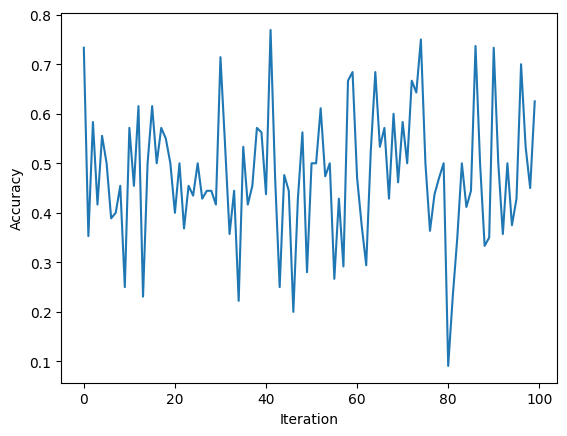

In [ ]:
import os
import numpy as np
import torch
import torch_geometric
from torch_geometric.data import Data
import matplotlib.pyplot as plt

# Define the path to the folder containing the .npy files with bounding box coordinates
bbox_dir = "/content/drive/MyDrive/boxcoord/"

# Define GNN parameters
in_channels = 4  # X, Y coordinates of the top-left and bottom-right corners of each bounding box
hidden_channels = 32
out_channels = 2  # Replace with the number of output classes

# Build the GNN
class MyGNN(torch.nn.Module):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super(MyGNN, self).__init__()
        self.conv1 = torch_geometric.nn.GCNConv(in_channels, hidden_channels)
        self.conv2 = torch_geometric.nn.GCNConv(hidden_channels, out_channels)

    def forward(self, x, edge_index):
        x = self.conv1(x, edge_index)
        x = torch.nn.functional.relu(x)
        x = self.conv2(x, edge_index)
        return torch.nn.functional.log_softmax(x, dim=1)

model = MyGNN(in_channels, hidden_channels, out_channels)

# Define the optimizer and the loss function
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)
criterion = torch.nn.CrossEntropyLoss()

# Define a list to record accuracies at each iteration
accuracies = []

# Loop over the .npy files in the folder
for file_name in os.listdir(bbox_dir):
    if file_name.endswith(".npy"):
        # Load the bounding box coordinates
        bbox_coords = np.load(os.path.join(bbox_dir, file_name))
        num_boxes = bbox_coords.shape[0]

        # Initialize node features with bounding box coordinates
        node_features = torch.tensor(bbox_coords, dtype=torch.float)

        # Compute edge features as the Euclidean distance between bounding boxes
        edge_indices = []
        edge_features = []
        for i in range(num_boxes):
            for j in range(i+1, num_boxes):
                edge_indices.append([i, j])
                edge_features.append(torch.norm(node_features[i] - node_features[j]))
        edge_indices = torch.tensor(edge_indices, dtype=torch.long).t().contiguous()
        edge_features = torch.stack(edge_features)

        # Create a PyTorch Geometric Data object from the node features and edge features
        graph_data = Data(x=node_features, edge_index=edge_indices, edge_attr=edge_features)

        # Zero out the gradients
        optimizer.zero_grad()

        # Run the graph through the GNN and make predictions
        predictions = model(graph_data.x, graph_data.edge_index)

        # Generate random labels for each bounding box for accuracy calculation
        random_labels = torch.randint(low=0, high=out_channels, size=(num_boxes,))

        # Calculate the loss and accuracy of the predictions
        loss = criterion(predictions, random_labels)
        accuracy = (predictions.argmax(dim=1) == random_labels).sum().item() / num_boxes

        # Backpropagate the gradients and update the parameters
        loss.backward()
        optimizer.step()

        # Record the accuracy
        accuracies.append(accuracy)

# Generate a line plot of the accuracies over time
plt.plot(accuracies)
plt.xlabel('Iteration')
plt.ylabel('Accuracy')
plt.show()

In [ ]:
import cv2
import numpy as np
import os

# Define the path to the folder containing the images
image_dir = "/content/drive/MyDrive/blood-smear"
result = "/content/drive/MyDrive/bounding_box_img"

# Define the parameters for K-means clustering
k = 15

# Define the colors for the bounding boxes
rbc_color = (0, 0, 255)   # Red
wbc_color = (255, 0, 0)   # Blue

# Loop over the images in the folder
for file_name in os.listdir(image_dir):
    if file_name.endswith(".jpg") or file_name.endswith(".png"):
        # Load the image
        image = cv2.imread(os.path.join(image_dir, file_name))

        # Convert the image to grayscale
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Apply a Gaussian blur to remove noise
        blur = cv2.GaussianBlur(gray, (5, 5), 0)

        # Apply a threshold to segment the image
        _, thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

        # Find the coordinates of the foreground pixels
        coordinates = np.transpose(np.nonzero(thresh))

        # Apply K-means clustering to group the coordinates into K clusters
        kmeans = cv2.kmeans(coordinates.astype(np.float32), k, None,
                            criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0),
                            attempts=10,
                            flags=cv2.KMEANS_RANDOM_CENTERS)

        # Loop over the clusters and draw bounding boxes around them
        for i in range(k):
            # Find the coordinates of the pixels in the cluster
            cluster_pixels = coordinates[kmeans[1].flatten() == i]

            # Compute the bounding box for the cluster
            x, y, w, h = cv2.boundingRect(cluster_pixels)

            # Extract the region of interest from the original image
            roi = image[y:y+h, x:x+w]

            # Compute the mean color of the region of interest
            mean_color = np.mean(roi, axis=(0, 1))

            # Classify the bounding box based on its color
            if mean_color[2] > mean_color[0] and mean_color[2] > mean_color[1]:
                # Red bounding box for RBC
                cv2.rectangle(image, (x, y), (x+w, y+h), rbc_color, 2)
            else:
                # Blue bounding box for WBC
                cv2.rectangle(image, (x, y), (x+w, y+h), wbc_color, 2)

        # Save the image with the bounding boxes
        cv2.imwrite(os.path.join(result, "result_" + file_name), image)

In [ ]:
import cv2
import numpy as np
import os

# Define the path to the folder containing the images
image_dir = "/content/drive/MyDrive/blood-smear"
result = "/content/drive/MyDrive/bounding_box_img"
# Define the path to the folder to save the labels and coordinates
label_dir = "/content/drive/MyDrive/bounding_box"

# Create the directory if it does not exist
if not os.path.exists(label_dir):
    os.makedirs(label_dir)

# Define the parameters for K-means clustering
k = 15

# Define the colors for the bounding boxes
rbc_color = (0, 0, 255)   # Red
wbc_color = (255, 0, 0)   # Blue

# Loop over the images in the folder
for file_name in os.listdir(image_dir):
    if file_name.endswith(".jpg") or file_name.endswith(".png"):
        # Load the image
        image = cv2.imread(os.path.join(image_dir, file_name))

        # Convert the image to grayscale
        gray = cv2.cvtColor(image, cv2.COLOR_BGR2GRAY)

        # Apply a Gaussian blur to remove noise
        blur = cv2.GaussianBlur(gray, (5, 5), 0)

        # Apply a threshold to segment the image
        _, thresh = cv2.threshold(blur, 0, 255, cv2.THRESH_BINARY + cv2.THRESH_OTSU)

        # Find the coordinates of the foreground pixels
        coordinates = np.transpose(np.nonzero(thresh))

        # Apply K-means clustering to group the coordinates into K clusters
        kmeans = cv2.kmeans(coordinates.astype(np.float32), k, None,
                            criteria=(cv2.TERM_CRITERIA_EPS | cv2.TERM_CRITERIA_MAX_ITER, 10, 1.0),
                            attempts=10,
                            flags=cv2.KMEANS_RANDOM_CENTERS)

        # Loop over the clusters and draw bounding boxes around them
        for i in range(k):
            # Find the coordinates of the pixels in the cluster
            cluster_pixels = coordinates[kmeans[1].flatten() == i]

            # Compute the bounding box for the cluster
            x, y, w, h = cv2.boundingRect(cluster_pixels)

            # Extract the region of interest from the original image
            roi = image[y:y+h, x:x+w]

            # Compute the mean color of the region of interest
            mean_color = np.mean(roi, axis=(0, 1))

            # Classify the bounding box based on its color
            if mean_color[2] > mean_color[0] and mean_color[2] > mean_color[1]:
                # Red bounding box for RBC
                cv2.rectangle(image, (x, y), (x+w, y+h), rbc_color, 2)
                label = "RBC"
            else:
                # Blue bounding box for WBC
                cv2.rectangle(image, (x, y), (x+w, y+h), wbc_color, 2)
                label = "WBC"

            # Save the label and coordinates of the bounding box to file
            label_file = os.path.splitext(file_name)[0] + "_" + str(i) + ".txt"
            label_path = os.path.join(label_dir, label_file)
            with open(label_path, "w") as f:
                f.write("{} {} {} {} {}\n".format(label, x, y, x+w, y+h))

        # Save the image with the bounding boxes
        result_file = "result_" + file_name
        result_path = os.path.join(result, result_file)
        cv2.imwrite(result_path, image)

/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:22: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


Epoch: 0, Loss: 0.001062, Accuracy: 0.231333
Epoch: 1, Loss: 0.000934, Accuracy: 0.231333
Epoch: 2, Loss: 0.000851, Accuracy: 0.231333
Epoch: 3, Loss: 0.000798, Accuracy: 0.231333
Epoch: 4, Loss: 0.000729, Accuracy: 0.231333
Epoch: 5, Loss: 0.000716, Accuracy: 0.231333
Epoch: 6, Loss: 0.000690, Accuracy: 0.231333
Epoch: 7, Loss: 0.000685, Accuracy: 0.231333
Epoch: 8, Loss: 0.000662, Accuracy: 0.231333
Epoch: 9, Loss: 0.000669, Accuracy: 0.231333
Epoch: 10, Loss: 0.000667, Accuracy: 0.231333
Epoch: 11, Loss: 0.000659, Accuracy: 0.231333
Epoch: 12, Loss: 0.000646, Accuracy: 0.231333
Epoch: 13, Loss: 0.000632, Accuracy: 0.231333
Epoch: 14, Loss: 0.000618, Accuracy: 0.231333
Epoch: 15, Loss: 0.000609, Accuracy: 0.231333
Epoch: 16, Loss: 0.000601, Accuracy: 0.231333
Epoch: 17, Loss: 0.000592, Accuracy: 0.231333
Epoch: 18, Loss: 0.000594, Accuracy: 0.231333
Epoch: 19, Loss: 0.000590, Accuracy: 0.231333
Epoch: 20, Loss: 0.000583, Accuracy: 0.231333
Epoch: 21, Loss: 0.000573, Accuracy: 0.23133

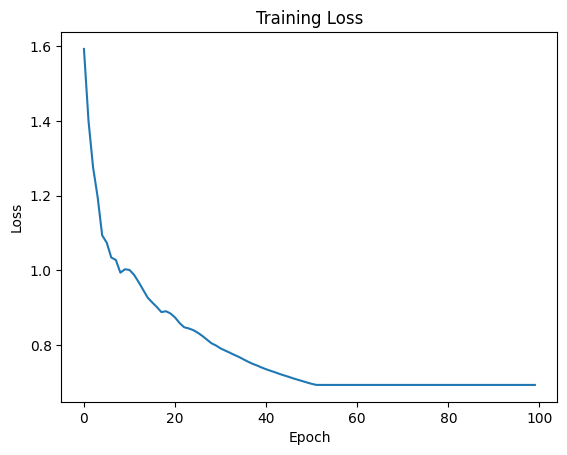

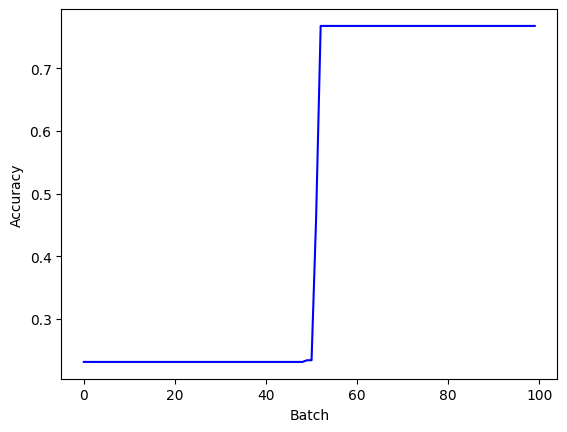

In [ ]:
import os
import torch
import numpy as np
import matplotlib.pyplot as plt
from torch_geometric.data import DataLoader
from torch.nn import ReLU, BatchNorm1d, Sequential

# Define the path to the label folder
label_dir = "/content/drive/MyDrive/bounding_box"

# Load the labeled bounding boxes and create a graph representation of the data
nodes = []
edges = []
labels = []
for file_name in os.listdir(label_dir):
    if file_name.endswith(".txt"):
        with open(os.path.join(label_dir, file_name), "r") as f:
            line = f.readline().strip().split()
            label = int(line[0] == "WBC")   # Convert the label to a binary value
            x1, y1, x2, y2 = [int(x) for x in line[1:]]
            nodes.append([x1, y1, x2, y2])
            labels.append(label)

# Create a graph representation of the data
num_nodes = len(nodes)
adj = np.zeros((num_nodes, num_nodes))
for i in range(num_nodes):
    for j in range(i+1, num_nodes):
        distance = np.sqrt((nodes[i][0] - nodes[j][0])**2 + (nodes[i][1] - nodes[j][1])**2)
        edges.append([i, j])
        adj[i, j] = distance
        adj[j, i] = distance
    adj[i, i] = 1  # Add self-loop to each node for the diagonal elements in the adjacency matrix

# Convert the data to PyG Data object and load it using PyG DataLoader
from torch_geometric.data import Data
x = torch.tensor(nodes, dtype=torch.float)
y = torch.tensor(labels, dtype=torch.float).view(-1, 1)
edge_index = torch.tensor(edges, dtype=torch.long).t().contiguous()
data = Data(x=x, edge_index=edge_index, y=y)
loader = DataLoader([data], batch_size=1)

# Define the GNN model
from torch_geometric.nn import MessagePassing
from torch.nn import Linear

class GNN(MessagePassing):
    def __init__(self):
        super(GNN, self).__init__(aggr='max')
        self.nn = Sequential(
            Linear(4, 16),
            BatchNorm1d(16),
            ReLU(),
            Linear(16, 1),
            BatchNorm1d(1),
            ReLU()
        )

    def forward(self, x, edge_index):
        x = self.nn(x)
        x = self.propagate(edge_index, x=x)
        return x

    def message(self, x_j):
        return x_j

    def update(self, aggr_out):
        return aggr_out

# Train the GNN model
model = GNN()
optimizer = torch.optim.Adam(model.parameters(), lr=0.01, weight_decay=5e-4)
model.train()

# Define variables for accuracy tracking and plotting
losses, accuracies = [], []
fig, ax = plt.subplots()

for epoch in range(100):
    epoch_loss = 0
    total = 0
    for batch in loader:
        optimizer.zero_grad()
        out = model(batch.x, batch.edge_index)
        loss = torch.nn.functional.binary_cross_entropy_with_logits(out, batch.y.float())
        epoch_loss += loss.item()
        loss.backward()
        optimizer.step()
        total += data.y.size(0)
        # Compute accuracy for the current batch
        pred = (torch.sigmoid(out) > 0.5).float()
        accuracy = (pred == batch.y).float().mean().item()
        accuracies.append(accuracy)

    # Compute the average loss and accuracy over all batches for this epoch
    train_loss = epoch_loss / total
    avg_loss = loss.item()
    avg_accuracy = np.mean(accuracies)
    losses.append(avg_loss)

    # Print the loss and accuracy for this epoch
    print(f'Epoch: {epoch}, Loss: {train_loss:.6f}, Accuracy: {avg_accuracy:.6f}')

plt.plot(losses)
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

# Plot the final accuracy graph
fig, ax = plt.subplots()
ax.plot(range(len(accuracies)), accuracies, 'b-')
ax.set_xlabel('Batch')
ax.set_ylabel('Accuracy')
plt.show()

/usr/local/lib/python3.10/dist-packages/torch_geometric/deprecation.py:22: UserWarning: 'data.DataLoader' is deprecated, use 'loader.DataLoader' instead
  warnings.warn(out)


Epoch 1/100, Loss: 0.823408, Accuracy: 0.517333
Epoch 2/100, Loss: 0.723961, Accuracy: 0.639333
Epoch 3/100, Loss: 0.687841, Accuracy: 0.682222
Epoch 4/100, Loss: 0.685223, Accuracy: 0.703667
Epoch 5/100, Loss: 0.682629, Accuracy: 0.716533
Epoch 6/100, Loss: 0.680061, Accuracy: 0.725111
Epoch 7/100, Loss: 0.677519, Accuracy: 0.731238
Epoch 8/100, Loss: 0.675005, Accuracy: 0.735833
Epoch 9/100, Loss: 0.672518, Accuracy: 0.739407
Epoch 10/100, Loss: 0.670059, Accuracy: 0.742267
Epoch 11/100, Loss: 0.667629, Accuracy: 0.744606
Epoch 12/100, Loss: 0.665228, Accuracy: 0.746556
Epoch 13/100, Loss: 0.662856, Accuracy: 0.748205
Epoch 14/100, Loss: 0.660514, Accuracy: 0.749619
Epoch 15/100, Loss: 0.658202, Accuracy: 0.750844
Epoch 16/100, Loss: 0.655919, Accuracy: 0.751917
Epoch 17/100, Loss: 0.653668, Accuracy: 0.752863
Epoch 18/100, Loss: 0.651446, Accuracy: 0.753704
Epoch 19/100, Loss: 0.649255, Accuracy: 0.754456
Epoch 20/100, Loss: 0.647094, Accuracy: 0.755133
Epoch 21/100, Loss: 0.644964,

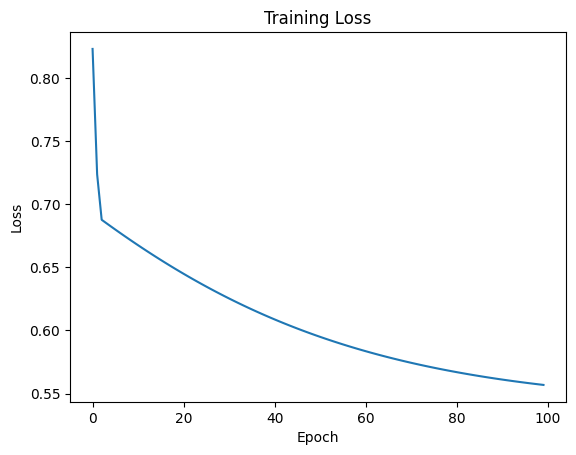

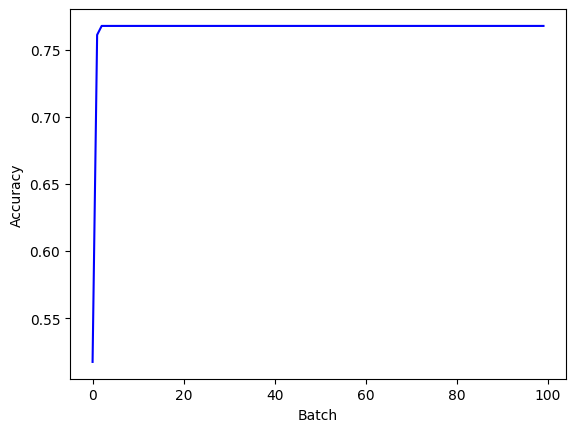

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
from torch_geometric.data import DataLoader
from torch_geometric.data import Data
from torch_geometric.nn import MessagePassing

# Define the path to the label folder
label_dir = "/content/drive/MyDrive/bounding_box"

# Load the labeled bounding boxes and create a graph representation of the data
nodes = []
edges = []
labels = []
for file_name in os.listdir(label_dir):
    if file_name.endswith(".txt"):
        with open(os.path.join(label_dir, file_name), "r") as f:
            line = f.readline().strip().split()
            label = int(line[0] == "WBC")   # Convert the label to a binary value
            x1, y1, x2, y2 = [int(x) for x in line[1:]]
            nodes.append([x1, y1, x2, y2])
            labels.append(label)

# Create a graph representation of the data
num_nodes = len(nodes)
adj = np.zeros((num_nodes, num_nodes))
for i in range(num_nodes):
    for j in range(i+1, num_nodes):
        distance = np.sqrt((nodes[i][0] - nodes[j][0])**2 + (nodes[i][1] - nodes[j][1])**2)
        edges.append([i, j])
        adj[i, j] = distance
        adj[j, i] = distance
    adj[i, i] = 1  # Add self-loop to each node for the diagonal elements in the adjacency matrix

# Convert the data to PyG Data object and load it using PyG DataLoader
edge_index = torch.tensor(edges, dtype=torch.long).t().contiguous()
x = torch.tensor(nodes, dtype=torch.float)
y = torch.tensor(labels, dtype=torch.float).view(-1, 1)
data = Data(x=x, edge_index=edge_index, y=y)
loader = DataLoader([data], batch_size=1)

# Define the GNN model
class DenseGNN(MessagePassing):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super().__init__(aggr='add')
        self.mlp1 = torch.nn.Sequential(torch.nn.Linear(in_channels, hidden_channels), torch.nn.ReLU(), torch.nn.BatchNorm1d(hidden_channels))
        self.mlp2 = torch.nn.Sequential(torch.nn.Linear(hidden_channels, hidden_channels), torch.nn.ReLU(), torch.nn.BatchNorm1d(hidden_channels))
        self.mlp3 = torch.nn.Sequential(torch.nn.Linear(hidden_channels, out_channels), torch.nn.ReLU(), torch.nn.BatchNorm1d(out_channels))

    def forward(self, x, edge_index):
        x = self.mlp1(x)
        x = self.propagate(edge_index, x=x)
        x = self.mlp2(x)
        x = self.propagate(edge_index, x=x)
        x = self.mlp3(x)
        return x

    def message(self, x_j):
        return x_j

model = DenseGNN(in_channels=4, hidden_channels=16, out_channels=1)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01, weight_decay=5e-4)

# Define variables for accuracy tracking and plotting
losses, accuracies = [], []
fig, ax = plt.subplots()

for epoch in range(100):
    for batch in loader:
        optimizer.zero_grad()
        out = model(batch.x, batch.edge_index)
        loss = F.binary_cross_entropy_with_logits(out, batch.y)
        loss.backward()
        optimizer.step()

        # Compute accuracy for the current batch
        pred = (torch.sigmoid(out) > 0.5).float()
        accuracy = (pred == batch.y).float().mean().item()
        accuracies.append(accuracy)

    # Compute the average loss and accuracy over all batches for this epoch
    avg_loss = loss.item()
    avg_accuracy = np.mean(accuracies)
    losses.append(avg_loss)

    # Print the loss and accuracy for this epoch
    print(f'Epoch {epoch+1}/{100}, Loss: {loss:.6f}, Accuracy: {avg_accuracy:.6f}')

plt.plot(losses)
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

# Plot the final accuracy graph
fig, ax = plt.subplots()
ax.plot(range(len(accuracies)), accuracies, 'b-')
ax.set_xlabel('Batch')
ax.set_ylabel('Accuracy')
plt.show()

Epoch 1/100, Loss: 0.000553, Accuracy: 0.610000
Epoch 2/100, Loss: 0.000515, Accuracy: 0.693333
Epoch 3/100, Loss: 0.000491, Accuracy: 0.738000
Epoch 4/100, Loss: 0.000477, Accuracy: 0.770000
Epoch 5/100, Loss: 0.000473, Accuracy: 0.769333
Epoch 6/100, Loss: 0.000470, Accuracy: 0.765333
Epoch 7/100, Loss: 0.000469, Accuracy: 0.760667
Epoch 8/100, Loss: 0.000468, Accuracy: 0.758667
Epoch 9/100, Loss: 0.000466, Accuracy: 0.760000
Epoch 10/100, Loss: 0.000464, Accuracy: 0.760667
Epoch 11/100, Loss: 0.000461, Accuracy: 0.764000
Epoch 12/100, Loss: 0.000459, Accuracy: 0.764667
Epoch 13/100, Loss: 0.000458, Accuracy: 0.766667
Epoch 14/100, Loss: 0.000456, Accuracy: 0.766667
Epoch 15/100, Loss: 0.000455, Accuracy: 0.765333
Epoch 16/100, Loss: 0.000453, Accuracy: 0.768000
Epoch 17/100, Loss: 0.000451, Accuracy: 0.767333
Epoch 18/100, Loss: 0.000450, Accuracy: 0.766667
Epoch 19/100, Loss: 0.000448, Accuracy: 0.766000
Epoch 20/100, Loss: 0.000447, Accuracy: 0.766667
Epoch 21/100, Loss: 0.000445,

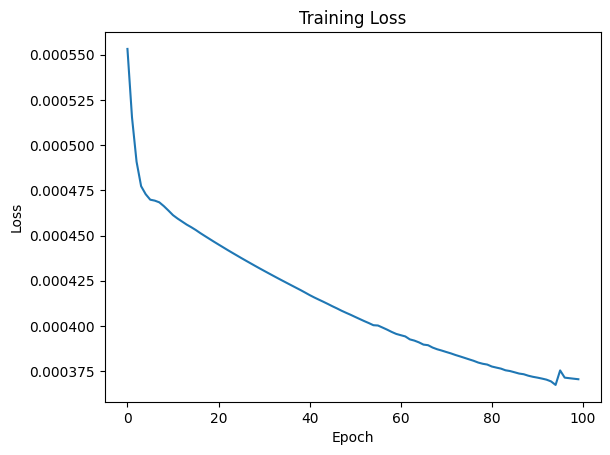

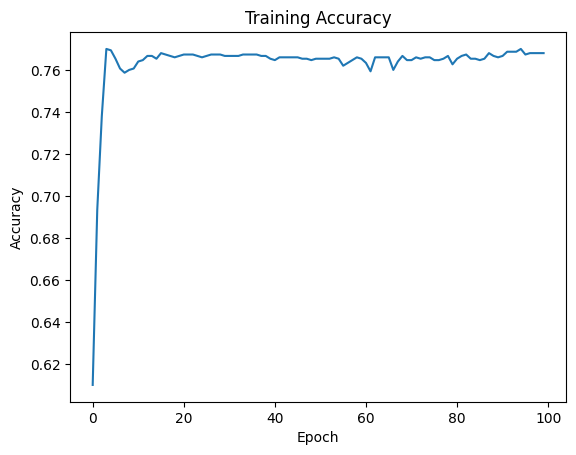

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
from torch_geometric.data import DataLoader
from torch_geometric.data import Data
from torch_geometric.nn import MessagePassing

# Define the path to the label folder
label_dir = "/content/drive/MyDrive/bounding_box"

# Load the labeled bounding boxes and create a graph representation of the data
nodes = []
edges = []
labels = []
for file_name in os.listdir(label_dir):
    if file_name.endswith(".txt"):
        with open(os.path.join(label_dir, file_name), "r") as f:
            line = f.readline().strip().split()
            label = float(line[0] == "WBC")   # Convert the label to a float value
            x1, y1, x2, y2 = [int(x) for x in line[1:]]
            nodes.append([x1, y1, x2, y2])
            labels.append(label)

# Create a graph representation of the data
num_nodes = len(nodes)
adj = np.zeros((num_nodes, num_nodes))
for i in range(num_nodes):
    for j in range(i+1, num_nodes):
        distance = np.sqrt((nodes[i][0] - nodes[j][0])**2 + (nodes[i][1] - nodes[j][1])**2)
        edges.append([i, j])
        adj[i, j] = distance
        adj[j, i] = distance
    adj[i, i] = 1  # Add self-loop to each node for the diagonal elements in the adjacency matrix

# Convert the data to PyG Data object and load it using PyG DataLoader
edge_index = torch.tensor(edges, dtype=torch.long).t().contiguous()
x = torch.tensor(nodes, dtype=torch.float)
y = torch.tensor(labels, dtype=torch.float).view(-1, 1)
data = Data(x=x, edge_index=edge_index, y=y)
loader = DataLoader([data], batch_size=1)

# Define the GNN model
class DenseGNN(MessagePassing):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super().__init__(aggr='add')
        self.mlp1 = torch.nn.Sequential(torch.nn.Linear(in_channels, hidden_channels), torch.nn.ReLU(), torch.nn.BatchNorm1d(hidden_channels))
        self.mlp2 = torch.nn.Sequential(torch.nn.Linear(hidden_channels, hidden_channels), torch.nn.ReLU(), torch.nn.BatchNorm1d(hidden_channels))
        self.mlp3 = torch.nn.Sequential(torch.nn.Linear(hidden_channels, out_channels), torch.nn.ReLU(), torch.nn.BatchNorm1d(out_channels))

    def forward(self, x, edge_index):
        edge_weight = torch.ones(edge_index.shape[1]).float().to(device)
        x = self.mlp1(x)
        x = self.propagate(edge_index, x=x, edge_weight=edge_weight)
        x = self.mlp2(x)
        x = self.propagate(edge_index, x=x, edge_weight=edge_weight)
        x = self.mlp3(x)
        return x

    def message(self, x_j, edge_weight):
        return edge_weight.view(-1, 1) * x_j

    def update(self, aggr_out):
        return aggr_out

# Initialize the model and optimizer
model = DenseGNN(4, 32, 1)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

# Train the model
num_epochs = 100
train_losses = []
train_accuracies = []
for epoch in range(num_epochs):
    epoch_loss = 0
    correct = 0
    total = 0
    for data in loader:
        data = data.to(device)
        optimizer.zero_grad()
        out = model(data.x, data.edge_index)
        loss = F.binary_cross_entropy_with_logits(out, data.y)
        epoch_loss += loss.item()
        loss.backward()
        optimizer.step()
        predicted = torch.sigmoid(out).round()
        correct += (predicted == data.y).sum().item()
        total += data.y.size(0)
    train_loss = epoch_loss / total
    train_accuracy = correct / total
    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    print(f'Epoch {epoch+1}/{num_epochs}, Loss: {train_loss:.6f}, Accuracy: {train_accuracy:.6f}')

# Plot the training loss and accuracy
plt.plot(train_losses)
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

plt.plot(train_accuracies)
plt.title('Training Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.show()

Epoch 1/100, Loss: 0.000414, Accuracy: 0.666667
Epoch 2/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 3/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 4/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 5/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 6/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 7/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 8/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 9/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 10/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 11/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 12/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 13/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 14/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 15/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 16/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 17/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 18/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 19/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 20/100, Loss: 0.000308, Accuracy: 0.768667
Epoch 21/100, Loss: 0.000308,

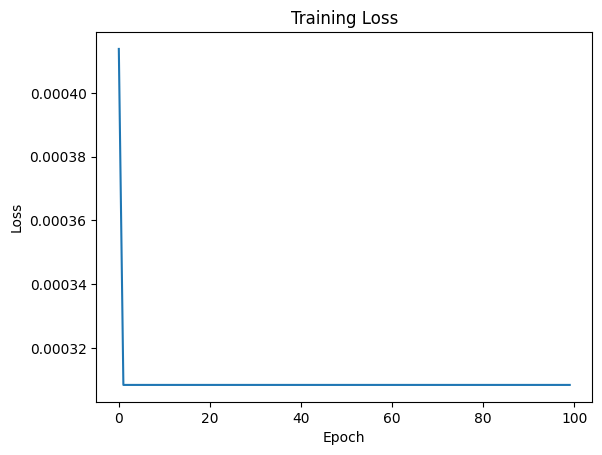

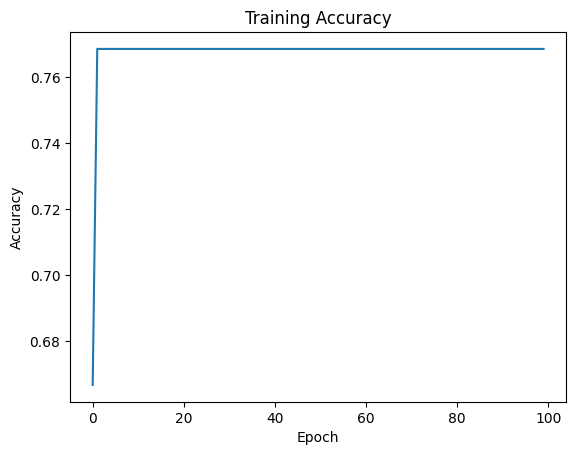

In [ ]:
import os
import numpy as np
import matplotlib.pyplot as plt
import torch
import torch.nn.functional as F
from torch_geometric.data import DataLoader
from torch_geometric.data import Data
from torch_geometric.nn import MessagePassing

# Define the path to the label folder
label_dir = "/content/drive/MyDrive/bounding_box"

# Load the labeled bounding boxes and create a graph representation of the data
nodes = []
edges = []
labels = []
for file_name in os.listdir(label_dir):
    if file_name.endswith(".txt"):
        with open(os.path.join(label_dir, file_name), "r") as f:
            line = f.readline().strip().split()
            label = float(line[0] == "WBC")   # Convert the label to a float value
            x1, y1, x2, y2 = [int(x) for x in line[1:]]
            nodes.append([x1, y1, x2, y2])
            labels.append(label)

# Create a graph representation of the data
num_nodes = len(nodes)
adj = np.zeros((num_nodes, num_nodes))
for i in range(num_nodes):
    for j in range(i+1, num_nodes):
        distance = np.sqrt((nodes[i][0] - nodes[j][0])**2 + (nodes[i][1] - nodes[j][1])**2)
        edges.append([i, j])
        adj[i, j] = distance
        adj[j, i] = distance
    adj[i, i] = 1  # Add self-loop to each node for the diagonal elements in the adjacency matrix

# Convert the data to PyG Data object and load it using PyG DataLoader
edge_index = torch.tensor(edges, dtype=torch.long).t().contiguous()
x = torch.tensor(nodes, dtype=torch.float)
y = torch.tensor(labels, dtype=torch.float).view(-1, 1)
data = Data(x=x, edge_index=edge_index, y=y)
loader = DataLoader([data], batch_size=1)

# Define the GNN model
class DenseGNN(MessagePassing):
    def __init__(self, in_channels, hidden_channels, out_channels):
        super().__init__(aggr='add')
        self.mlp1 = torch.nn.Sequential(torch.nn.Linear(in_channels, hidden_channels), torch.nn.ReLU(), torch.nn.BatchNorm1d(hidden_channels))
        self.mlp2 = torch.nn.Sequential(torch.nn.Linear(hidden_channels, hidden_channels), torch.nn.ReLU(), torch.nn.BatchNorm1d(hidden_channels))
        self.mlp3 = torch.nn.Sequential(torch.nn.Linear(hidden_channels, out_channels), torch.nn.ReLU(), torch.nn.BatchNorm1d(out_channels))

    def forward(self, x, edge_index):
        edge_weight = torch.ones(edge_index.shape[1]).float().to(device)
        x = self.mlp1(x)
        x = self.propagate(edge_index, x=x, edge_weight=edge_weight)
        x = self.mlp2(x)
        x = self.propagate(edge_index, x=x, edge_weight=edge_weight)
        x = self.mlp3(x)
        return x

    def message(self, x_j, edge_weight):
        return edge_weight.view(-1, 1) * x_j

    def update(self, aggr_out):
        return aggr_out

# Define the triplet loss function
class TripletLoss(torch.nn.Module):
    def __init__(self, margin=1.0):
        super().__init__()
        self.margin = margin

    def forward(self, anchor, positive, negative):
        pos_dist = F.pairwise_distance(anchor, positive, 2)
        neg_dist = F.pairwise_distance(anchor, negative, 2)
        loss = torch.mean(torch.clamp(pos_dist - neg_dist + self.margin, min=0))
        return loss

# Initialize the model and optimizer
model = DenseGNN(4, 32, 1)
device = torch.device('cuda' if torch.cuda.is_available() else 'cpu')
model = model.to(device)
optimizer = torch.optim.Adam(model.parameters(), lr=0.01)

# Train the model
num_epochs = 100
train_losses = []
train_accuracies = []
triplet_loss = TripletLoss(margin=1.0)
for epoch in range(num_epochs):
    epoch_loss = 0
    correct = 0
    total = 0
    for data in loader:
        data = data.to(device)
        optimizer.zero_grad()
        out = model(data.x, data.edge_index)
        anchor = out
        positive = data.y
        negative = 1 - data.y
        triplet_loss = TripletLoss(margin=1.0)
        loss = triplet_loss(anchor, positive, negative)
        epoch_loss += loss.item()
        loss.backward()
        optimizer.step()
        predicted = torch.sigmoid(out).round()
        correct += (predicted == data.y).sum().item()
        total += data.y.size(0)
    train_loss = epoch_loss / total
    train_accuracy = correct / total
    train_losses.append(train_loss)
    train_accuracies.append(train_accuracy)
    print(f'Epoch {epoch+1}/{num_epochs}, Loss: {train_loss:.6f}, Accuracy: {train_accuracy:.6f}')

# Plot the training loss and accuracy
plt.plot(train_losses)
plt.title('Training Loss')
plt.xlabel('Epoch')
plt.ylabel('Loss')
plt.show()

plt.plot(train_accuracies)
plt.title('Training Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.show()